# Manga panel colorization using cGANs (Conditional GAN)


## Introduction

The purpose of this project is to get a better understanding of
GAN, cGANs and other topics in deep learning that is related to
Image Colorization, specifically in this case Anime Line Art Colorization

By: Pongsakorn Samotong (6181207) & Philippe Sagon (6181091)

***This project is an adaptation from the paper [Image-to-Image Translation with Conditional Adversarial Networks](https://arxiv.org/pdf/1611.07004.pdf)***

## Network Architecture & Model

### Generator

For our Generator, we will use Pix2Pix 

Pix2Pix is an image-to-image translation Generative Adversarial Networks that learns a mapping from an image X and a random noise Z to output image Y or in simple language it learns to translate the source image into a different distribution of image.

![Pix2Pix Generator](https://ik.imagekit.io/aniket/blog/pix2pix/pix2pix_Unet_arch_Oen99KmZw)

Pix2Pix Generator is an U-Net based architecture which is an encoder-decoder network with skip connections. The name U-Net highlights the structure of the "U" shaped network.

Encoder: 
- C64-C128-C256-C512-C512-C512-C512-C512
- Each block contain Conv2d (stride=2), batch_norm layer (except first block), apply leaky relu

Decoder: 
- CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128
- Each block contain transposed conv2d, dropout layer (first 3 block), relu layer

Properties:
- Last layer uses a single convolutional layer with three channels and tanh activation function which is commonly used for GAN Model
- Skip connection between i-th encoder and (n-i)-th decoder

### Discriminator

We will use PatchGAN Discriminator

About PatchGAN: PatchGAN is the discriminator used for Pix2Pix. Its architecture is different from a typical image classification ConvNet because of the output layer size. In convnets output layer size is equal to the number of classes while in PatchGAN output layer size is a 2D matrix.

![PatchGAN Discriminator](https://www.researchgate.net/profile/Gozde-Unal-2/publication/323904616/figure/fig1/AS:606457334595585@1521602104652/PatchGAN-discriminator-Each-value-of-the-output-matrix-represents-the-probability-of.png)

Properties: 
- C64-C128-C256-C512
- Each block contain Conv2d (stride=2), batch_norm layer (except first block), apply leaky relu
- The output will be 16x16x1 map which each value represent a patch from the image.

## Loss functions

***Generator loss = GAN Loss + $λ$ * L1***, where $λ = 100$

***Discriminator loss: real_loss + generated_loss***

***(Explanation below)***


### Generator loss

GAN Loss: $$𝓛_{cGAN}(G,D) = 𝔼_{x,y}[logD(x,y)] + 𝔼_{x,z}[log(1-D(x,G(x,z))] $$

Where G tries to minimize this objective against an adversarial D that tries to maximize it, i.e. G∗ =
arg minG maxD LcGAN (G, D).

To test the importance of conditioning the discriminator,
we also compare to an unconditional variant in which the
discriminator does not observe x:

$$ 𝓛_{cGAN}(G,D) = 𝔼_{y}[logD(y)] + 𝔼_{x,z}[log(1-D(G(x,z))] $$

L1 (we used L1 because of less blurring): $$𝓛_{L1(G)} = 𝔼_{x,y,z}[|y-G(x,z)|_1] $$

Our Generator loss functions is equal to:

$$𝓛_{cGAN}(G,D) + \lambda𝓛_{L1}$$

### Discriminator loss

***Markovian discriminator (PatchGAN)***

PatchGAN is a type of discriminator for generative adversarial networks which only penalizes structure at the scale of local image patches. The PatchGAN discriminator tries to classify if each N × N patch in an image is real or fake.

***Advantages of using PatchGAN***: a smaller
PatchGAN has fewer parameters, runs faster, and can be
applied to arbitrarily large images.

Such a discriminator effectively models the image as a
Markov random field, assuming independence between pixels separated by more than a patch diameter.

***Discriminator loss***: sum of the binary cross entropy loss when the discriminator is fed with the real image and when the discriminator is fed with generated image


## Evaluation Methods

**These are the evaluation method used by Pix2Pix [paper](https://arxiv.org/abs/1611.07004)**

- [Peak Signal to Noise Ratio](https://en.wikipedia.org/wiki/Peak_signal-to-noise_ratio) (PSNR)

**PSNR** is an engineering term for the ratio between the maximum possible power of a signal and the power of corrupting noise that affects the fidelity of its representation. As you can see the term "Ratio" in words, it is usually expressed in terms of logarithmic decibel (dB) scale, and has following relation,

$$ \begin{aligned} PSNR &= 10 \cdot \log_{10} \Big(\frac{\text{MAX}_I^2}{\text{MSE}}\Big) \\ &= 20 \cdot \log_{10}(\text{MAX}_I) - 10 \cdot \log_{10}(\text{MSE}) \end{aligned} $$

Where $I$ is monochrome image and $K$ is its noisy approximation. Expressed in dB scale,

- [Mean Squared Error](https://en.wikipedia.org/wiki/Mean_squared_error) (MSE)

**MSE** is the average squared difference between the estimated values and the actual value. MSE is a risk function, corresponding to the expected value of the squared error loss. As it is derived from the square of Euclidean distance, it is always a positive value that decreases as the error approaches zero.

$$ \text{MSE} = \frac{1}{mn} \sum_{i=0}^{m-1} \sum_{j=0}^{n-1}[I(i, j) - K(i, j)]^2 $$

- [Structural Similarity](https://en.wikipedia.org/wiki/Structural_similarity) (SSIM)

**SSIM** is a method for predicting the perceived quality, and it is used for measureing the similarity between two images. If this value is close to 1, then two images are identical. Otherwise, two images will be totally different. Think about it that we can increase PSNR while maintaining the SSIM. That maybe works in CNN. So it is required to define these metrics.

$$ \text{SSIM(x,y)} = \frac{(2μ_xμ_y+c_1)(2σ_{xy}+c_2)}{(μ^2_x+μ^2_y+c_1)(σ^2_x+σ^2_y+c_2)} $$




**Source code can be obtain through author [GitHub](https://github.com/phillipi/pix2pix)**


## Dataset

1. [Anime Sketch Colorization Pair (Kaggle)](https://www.kaggle.com/datasets/ktaebum/anime-sketch-colorization-pair)
2. [Tagged Anime Illustrations (Kaggle)](https://www.kaggle.com/datasets/mylesoneill/tagged-anime-illustrations)
3. [Manga Colorization (sudheerachary)](https://github.com/sudheerachary/Manga_Colorization/tree/master/datasets)

# Coding

### Imports

1. Numpy (Mathetical functions)
2. Torch/PyTorch (Machine Learning framework for Computer Vision)
3. sklearn/scikit-learn (Machine Learning tools)
4. PIL (Image)
5. Request (URL request for obtaining the image)
6. glob (used to return all file paths that match a specific pattern)

In [ ]:
import tensorflow as tf
import os
import numpy as np
import glob
from matplotlib import pyplot as plt
%matplotlib inline
import time
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model, Sequential
from tensorflow.keras.layers import (Conv2D, BatchNormalization, 
LeakyReLU, Conv2DTranspose, Dropout, ReLU, Input, Concatenate, concatenate)
from tqdm import tqdm
import pathlib
import datetime
from IPython import display

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Preprocessing

***xDog Implementations (eXtended difference-of-Gaussians)***

**Usage:** Algorithm we use to generate a synthetic sketches-drawing pairs.

According to the paper the value for each variable in xDoG algorithm are set to:\
**φ** (phi) = 1 x 10^9 (to keep a step transition at the border of sketch lines)\
**σ** (sigma) = [0.3/0.4/0.5] random (to get different levels of line thickness thus generalize the network on various line width)\
**τ** (tau) = 0.95\
**κ** = 4.5 as default

**References:**
- https://www.kyprianidis.com/p/cag2012/winnemoeller-cag2012.pdf
- https://github.com/heitorrapela/xdog
- https://github.com/garygrossi/XDoG-Python
- https://github.com/n1kkqt/line-art-colorization

In [ ]:
# official implementation obtained from the reference above
import cv2
import numpy as np
from PIL import Image
import requests

# Difference of Gaussians applied to img input
def dog(img,size=(0,0),k=1.6,sigma=0.5,gamma=1):

  # Computes the Difference of Gaussians (DoG) for a given image. Returns an image 
  # that results from computing the DoG. 
  # image: an n x m array for which the DoG is computed.
  # k: the multiplier the the second Gaussian sigma value.
  # gamma: the multiplier for the second Gaussian result.
  
  # return: an n x m array representing the DoG

    img1 = cv2.GaussianBlur(img,size,sigma)
    img2 = cv2.GaussianBlur(img,size,sigma*k)
    return (img1-gamma*img2)
 
# version of xdog inspired by article
def xdog(img,sigma=0.5,k=1.6, gamma=1,epsilon=1,phi=1):

  # Computes the eXtended Difference of Gaussians (XDoG) for a given image. This 
  # is done by taking the regular Difference of Gaussians, thresholding it
  # at some value, and applying the hypertangent function the the unthresholded
  # values.
  # image: an n x m single channel matrix.
  # epsilon: the offset value when computing the hypertangent.

  # returns: an n x m single channel matrix representing the XDoG.

    aux = dog(img,sigma=sigma,k=k,gamma=gamma)/255
    for i in range(0,aux.shape[0]):
        for j in range(0,aux.shape[1]):
            if(aux[i,j] < epsilon):
                aux[i,j] = 1*255
            else:
                aux[i,j] = 255*(1 + np.tanh(phi*(aux[i,j])))
    return aux


def to_sketch(img_orig, sigma=0.4, k=4.5, gamma=0.92, epsilon=-1, phi=10e9, area_min=2):

    # According to the paper the parameter for xDoG algorithm are set to:
    #   φ (phi) = 1 x 10^9 (to keep a step transition at the border of sketch lines)
    #   σ (sigma) = [0.3/0.4/0.5] random (to get different levels of line thickness thus generalize the network on various line width)
    #   τ (tau) = 0.95
    #   κ = 4.5 as default.

    img_cnts = []
    img = cv2.cvtColor(np.array(img_orig), cv2.COLOR_RGB2GRAY)
    img_xdog = xdog(img, sigma=sigma, k=k, gamma=gamma, epsilon=epsilon, phi=phi).astype(np.uint8)
    new_img = np.zeros_like(img_xdog)
    thresh = cv2.threshold(img_xdog, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    for c in cnts:
        area = cv2.contourArea(c)
        if area > area_min:
            img_cnts.append(c)

    return Image.fromarray(255 - cv2.drawContours(new_img, img_cnts, -1, (255,255,255), -1))

In [ ]:
def sketch_img(path):
    img_orig, = Image.open(path).convert('RGB')
    sketch_test = to_sketch(img_orig, sigma=0.5, k=4.5, gamma=0.92, epsilon=-1, phi=10e9, area_min=2)
    return img_orig,sketch_test

def sketch_link(link):
    img_orig = Image.open(requests.get(link, stream=True).raw).convert('RGB')
    sketch_test = to_sketch(img_orig, sigma=0.5, k=4.5, gamma=0.92, epsilon=-1, phi=10e9, area_min=2)
    return img_orig, sketch_test

***Testing our xDoG implementaion used to sketch the image***

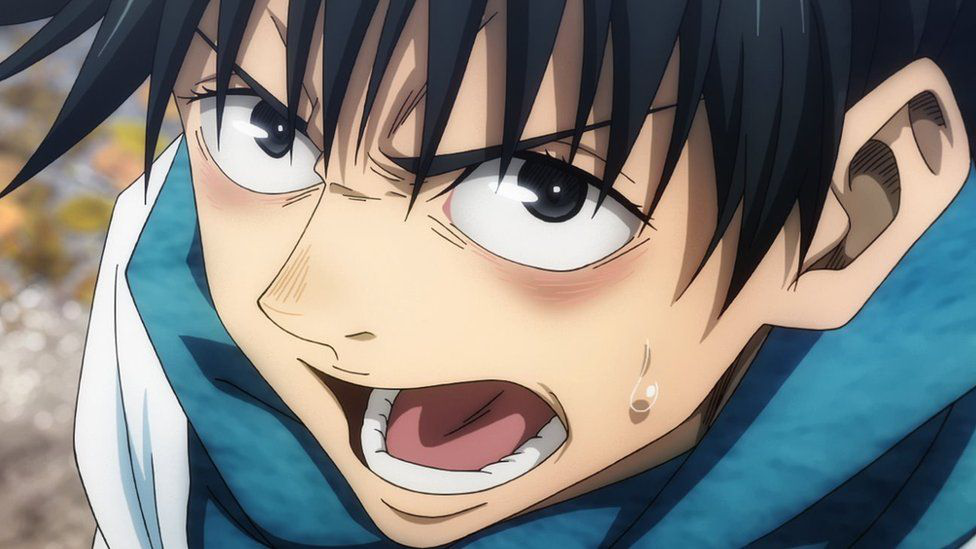

In [ ]:
origin, sketch = sketch_link("https://ichef.bbci.co.uk/news/976/cpsprodpb/F382/production/_123883326_852a3a31-69d7-4849-81c7-8087bf630251.jpg")
origin

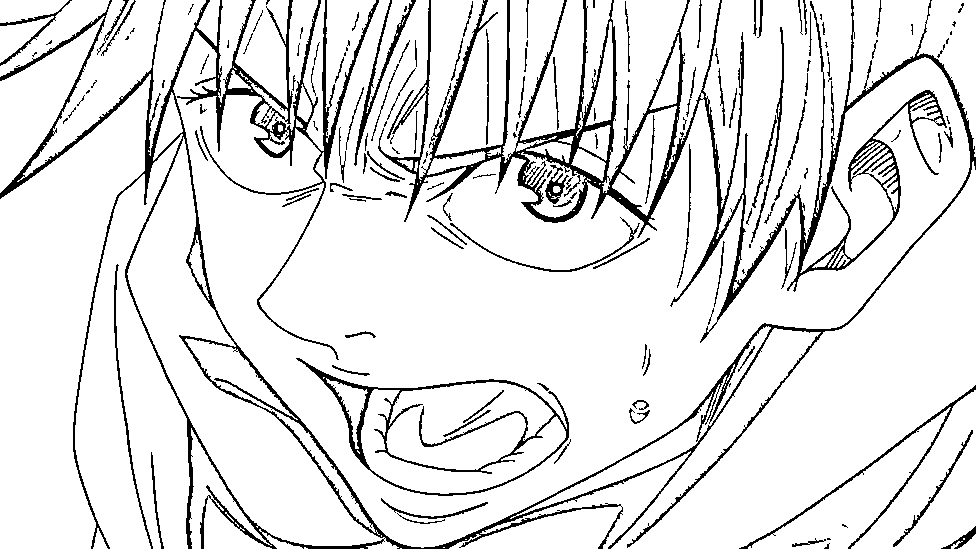

In [ ]:
sketch

***Image tools & Functions***

In [ ]:
# read and convert image into tensor array
def read_png(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_png(img, channels=3)
    return img

# flip the image
def flip_image(image):
    return tf.image.flip_left_right(image)

# flip the image and applying random jitter
def random_jitter(decolored_image, colored_image):
    if tf.random.uniform(()) > 0.5:
        decolored_image = flip_image(decolored_image)
        colored_image = flip_image(colored_image)
    return decolored_image, colored_image

# normalize both image into [-1 to 1] range
def normalize(decolored_image, colored_image):
    decolored_image = tf.cast(decolored_image, tf.float32)/127.5 - 1
    colored_image = tf.cast(colored_image, tf.float32)/127.5 - 1
    return decolored_image, colored_image

***Loading dataset (train and test)***

In [ ]:
def load_image(image_path):
    colored_image = read_png(image_path[0])
    decolored_image = read_png(image_path[1])

    colored_image = tf.image.resize(colored_image, (256, 256))
    decolored_image = tf.image.resize(decolored_image, (256, 256))

    if tf.random.uniform(()) > 0.5:
        colored_image = tf.image.flip_left_right(colored_image)
        decolored_image = tf.image.flip_left_right(decolored_image)

    colored_image, decolored_image = normalize(colored_image,decolored_image)

    return decolored_image, colored_image

## Loading and Pipelining the dataset

**(Details about data pipelining can be read more [here](https://www.tensorflow.org/guide/data))**

***Defining variables & Assigning values***

In [ ]:
# defining path for training and testing dataset
# path depends on your setup, this vary for others make sure to look properly
train_path_colored = '/content/drive/MyDrive/DL/Datasets/train_colored'
train_path_decolored = '/content/drive/MyDrive/DL/Datasets/train_decolored'
train_images_path = [[os.path.join(train_path_colored, image_name), os.path.join(train_path_decolored, image_name)] for image_name in os.listdir(train_path_colored) ]
print("Train image count:",len(train_images_path)) 

test_path_colored = '/content/drive/MyDrive/DL/Datasets/test_data_colored'
test_path_decolored = '/content/drive/MyDrive/DL/Datasets/test_data_decolored'
test_images_path = [[os.path.join(test_path_colored, image_name), os.path.join(test_path_decolored, image_name)] for image_name in os.listdir(test_path_colored) ]
print("Train image count:",len(test_images_path)) 


# defining batch and buffer size for pipelining the dataset
# both values are obtained from the papers (pix2pix shoes edges detection)
BATCH_SIZE = 4
BUFFER_SIZE = 400

Train image count: 160
Train image count: 8


***Loading and pipelining the training dataset***

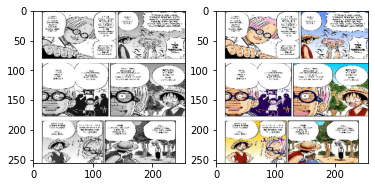

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_images_path)
train_dataset = train_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

for decolored, color in train_dataset.take(1):
    
    plt.subplot(1,2,1)
    plt.imshow(tf.keras.preprocessing.image.array_to_img(decolored[0]))
    plt.subplot(1,2,2)
    plt.imshow(tf.keras.preprocessing.image.array_to_img(color[0]))

***Loading and pipelining the testing dataset***

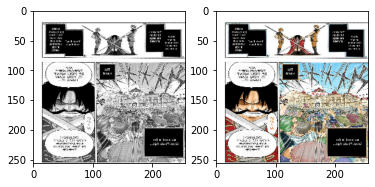

In [ ]:
test_dataset = tf.data.Dataset.from_tensor_slices(test_images_path)
test_dataset = test_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(1)

for decolored, color in test_dataset.take(1):

    plt.subplot(1,2,1)
    plt.imshow(tf.keras.preprocessing.image.array_to_img(decolored[0]))
    plt.subplot(1,2,2)
    plt.imshow(tf.keras.preprocessing.image.array_to_img(color[0]))

## Creating the model

***Block used to structure our generator and discriminator***

In [ ]:
OUTPUT_CHANNELS = 3

def downsample(filters, size, apply_batchnorm=True):
    block = Sequential()
    block.add(Conv2D(filters, size, strides=2, padding='same', use_bias=False))

    if apply_batchnorm:
        block.add(BatchNormalization())
        
    block.add(LeakyReLU())

    return block

def upsample(filters, size, apply_dropout=False):
    block = Sequential()
    block.add(Conv2DTranspose(filters, size, strides=2, padding='same', use_bias=False))
    block.add(BatchNormalization())

    if apply_dropout:
        block.add(Dropout(0.5))

    block.add(ReLU())

    return block

***Generator***

In [ ]:
def Generator():
    inp = Input(shape=[256,256,3])
    x = inp
    
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    
    bottleneck = downsample(512, 4)
    # decoder stack
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]

    last_layer = Conv2DTranspose(OUTPUT_CHANNELS, 4, strides=2, padding='same', activation='tanh')
    
    # Downsampling
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    x = bottleneck(x)
    skips.reverse()

    # Upsampling + creating skip connections for the i-th encoder and (n-i)-th decoder
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last_layer(x)

    return Model(inputs=inp, outputs=x)

***Discriminator***

In [ ]:
def Discriminator():
    inp = Input(shape=[256, 256, 3], name='decolored_image')
    target = Input(shape=[256, 256, 3], name='colored_image')

    x = concatenate([inp, target])
    
    block_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4)
    ]
    
    last_layer = Conv2D(1, 4, strides=1, padding='same')
    
    for block in block_stack:
        x = block(x)
    
    x = last_layer(x)

    return Model(inputs=[inp, target], outputs=x)

## Model Summary & Visualization

***Generator***

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 128)  131584      ['sequential[0][0]']             
                                                                                              

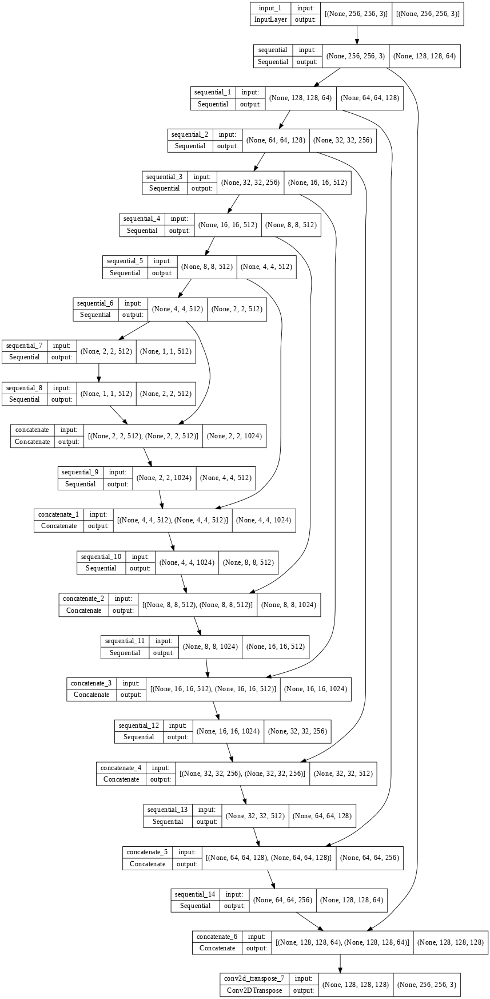

In [ ]:
generator = Generator()
generator.summary()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

***Discriminator***

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 decolored_image (InputLayer)   [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 colored_image (InputLayer)     [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 concatenate_7 (Concatenate)    (None, 256, 256, 6)  0           ['decolored_image[0][0]',        
                                                                  'colored_image[0][0]']    

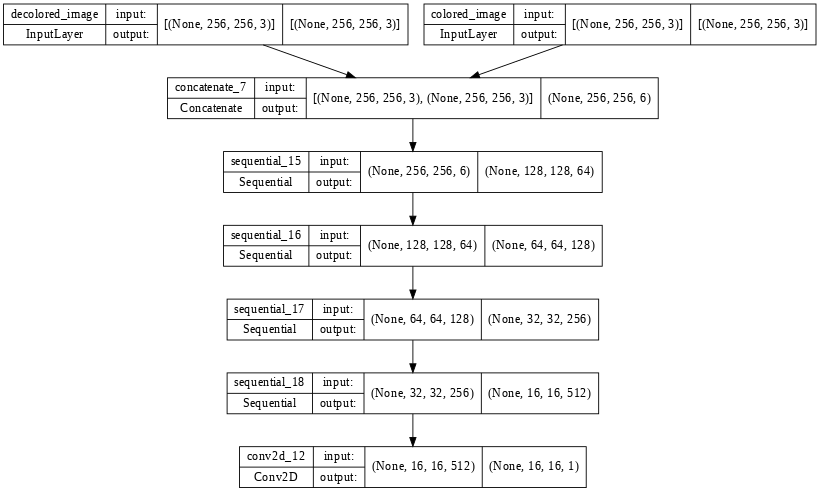

In [ ]:
discriminator = Discriminator()
discriminator.summary()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

## Loss functions

***Generator & Discriminator Loss Function***

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
LAMBDA = 100

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    return gan_loss + (LAMBDA * l1_loss)  

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    
    return real_loss + generated_loss

## Defining Optimizers

We will use ***learning rate = 2e-4*** and ***Beta = 0.5***, which was obtain from the paper

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Generating Samples

In [ ]:
def generate_images(model, test_input, target):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(16,16))

    plt.subplot(1, 3, 1)
    plt.title("Sketch Image")
    plt.imshow(test_input[0]*0.5+0.5)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Target Image")
    plt.imshow(target[0]*0.5+0.5)
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("Predicted Image")
    plt.imshow(prediction[0]*0.5+0.5)
    plt.axis('off')
    
    plt.show()

    return prediction[0]*0.5+0.5

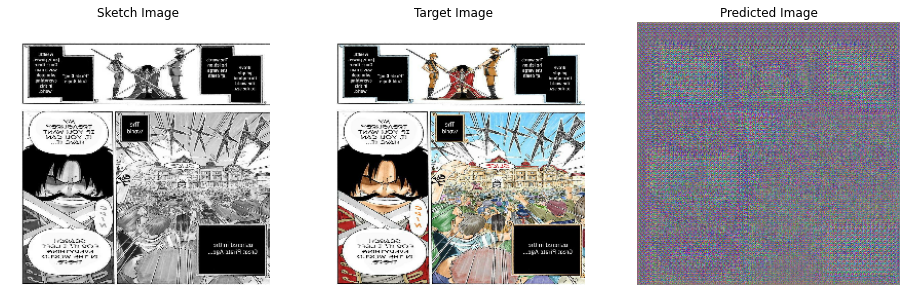

In [ ]:
# Testing
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

## Training our model

Defining custom Pix2Pix Training Step

- Guide (adaptation from): https://keras.io/guides/writing_a_training_loop_from_scratch/

Steps: 
1. Generate losses for generator and discriminator
2. Calculate the loss gradient
3. Apply it to the optimizer

In [ ]:
# Set the EPOCHS here
EPOCHS = 30

@tf.function
def train_step(sketch_image, ground_truth, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generator_output = generator(sketch_image, training=True)

        disc_real_output = discriminator([sketch_image, ground_truth], training=True)
        disc_generated_output = discriminator([sketch_image, generator_output], training=True)

        gen_loss = generator_loss(disc_generated_output, generator_output, ground_truth)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))
    return gen_loss, disc_loss

epoch_loss_avg_gen = tf.keras.metrics.Mean('g_loss')
epoch_loss_avg_disc = tf.keras.metrics.Mean('d_loss')

generator_mean_losses = []
discriminator_mean_losses = []

***Training Loops***

In [ ]:
def fit(train_ds, epochs, test_ds):
    for epoch in range(1, epochs+1):
        for example_input, example_target in test_ds.take(1):
            generate_images(generator, example_input, example_target)
        print("Epoch: ", epoch)
        
        for n, (sketch_image, colored_image) in tqdm(train_ds.enumerate()):
            g_loss, d_loss = train_step(sketch_image, colored_image, epoch)
            epoch_loss_avg_gen(g_loss)
            epoch_loss_avg_disc(d_loss)
             
        print()
        print("Generator Loss: %.2f" % epoch_loss_avg_gen.result().numpy())
        print("Discriminator Loss: %.2f" % epoch_loss_avg_disc.result().numpy())
        print("=====================================================")
        
        generator_mean_losses.append(epoch_loss_avg_gen.result().numpy())
        discriminator_mean_losses.append(epoch_loss_avg_disc.result().numpy())
        
        epoch_loss_avg_gen.reset_states()
        epoch_loss_avg_disc.reset_states()

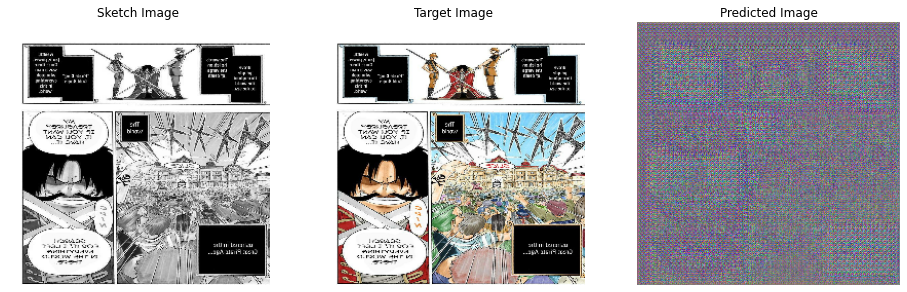

Epoch:  1


100%|██████████| 40/40 [00:20<00:00,  1.95it/s]



Generator Loss: 41.99
Discriminator Loss: 1.31


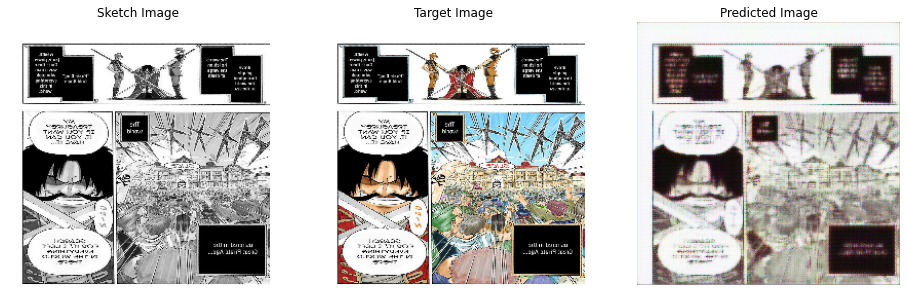

Epoch:  2


100%|██████████| 40/40 [00:08<00:00,  4.67it/s]



Generator Loss: 21.15
Discriminator Loss: 1.04


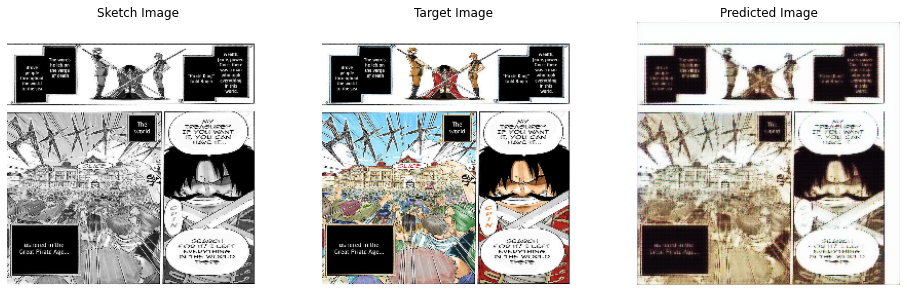

Epoch:  3


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 17.50
Discriminator Loss: 1.05


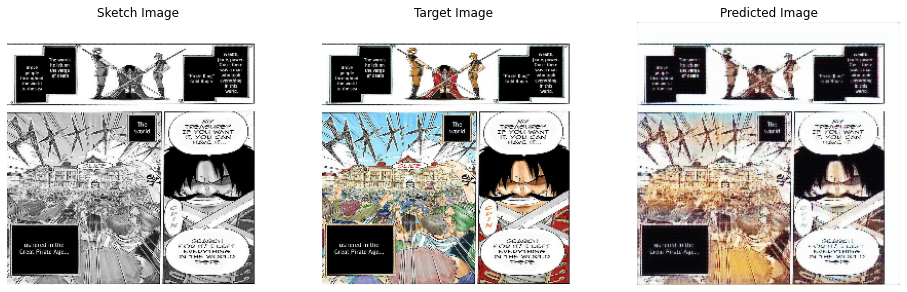

Epoch:  4


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 15.82
Discriminator Loss: 0.97


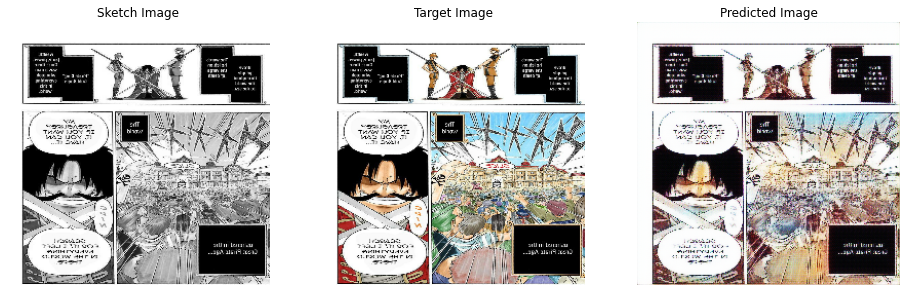

Epoch:  5


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 14.68
Discriminator Loss: 1.09


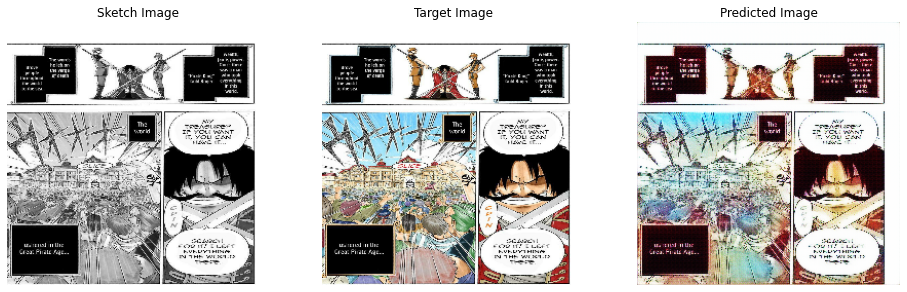

Epoch:  6


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 13.97
Discriminator Loss: 1.19


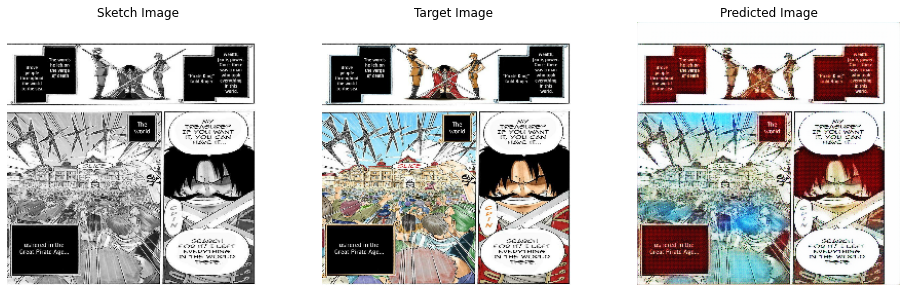

Epoch:  7


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 13.57
Discriminator Loss: 1.21


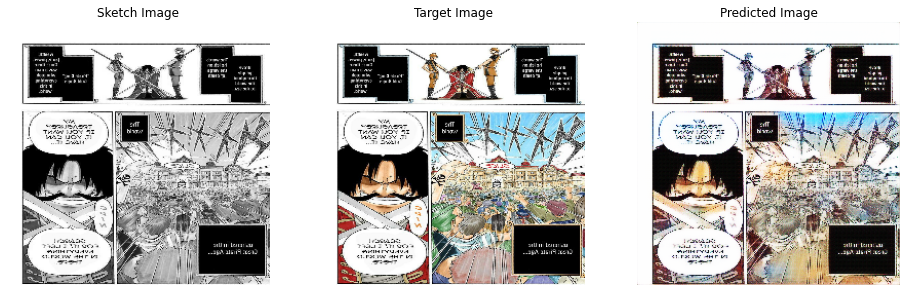

Epoch:  8


100%|██████████| 40/40 [00:08<00:00,  4.48it/s]



Generator Loss: 13.02
Discriminator Loss: 1.15


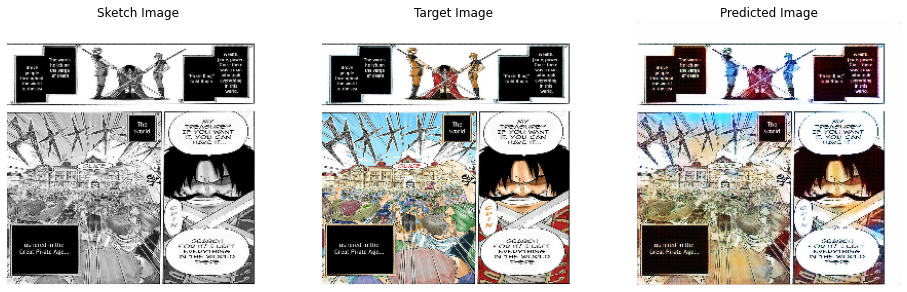

Epoch:  9


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 12.68
Discriminator Loss: 1.12


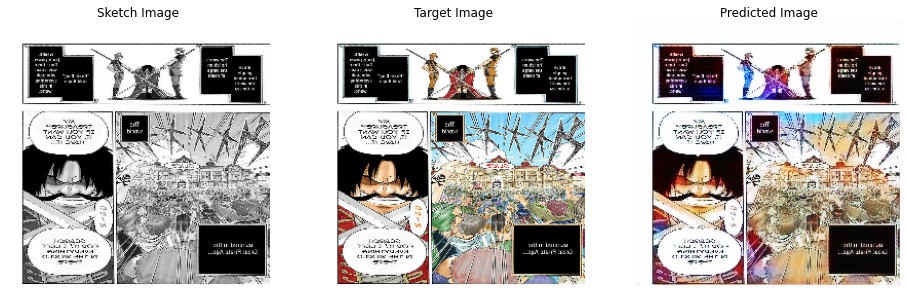

Epoch:  10


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 12.35
Discriminator Loss: 1.16


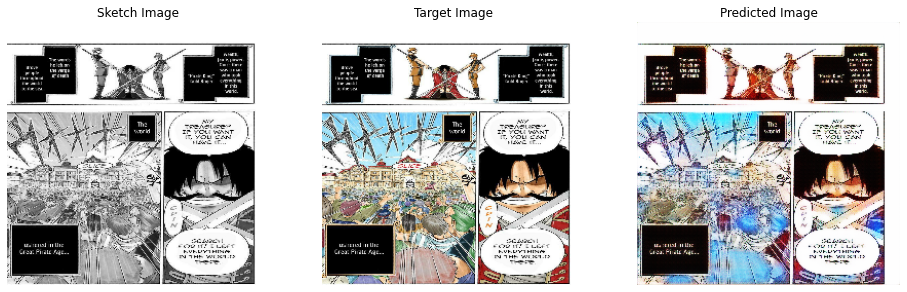

Epoch:  11


100%|██████████| 40/40 [00:10<00:00,  3.90it/s]



Generator Loss: 12.25
Discriminator Loss: 1.13


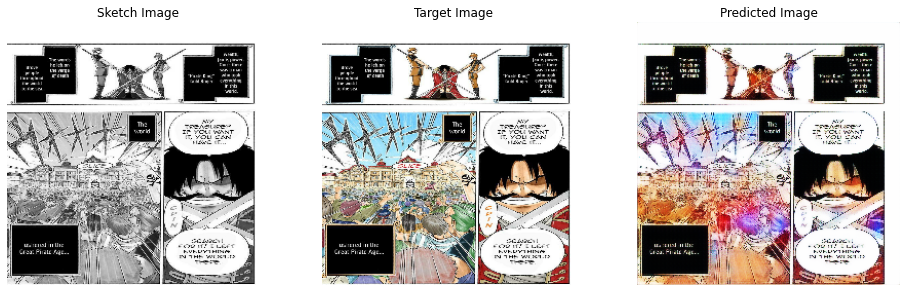

Epoch:  12


100%|██████████| 40/40 [00:08<00:00,  4.55it/s]



Generator Loss: 11.81
Discriminator Loss: 1.12


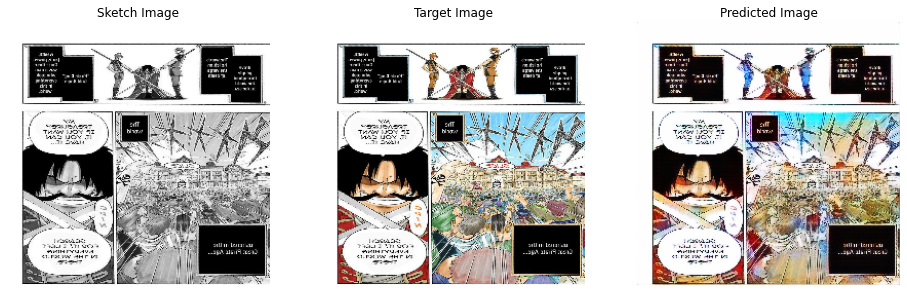

Epoch:  13


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 11.70
Discriminator Loss: 1.18


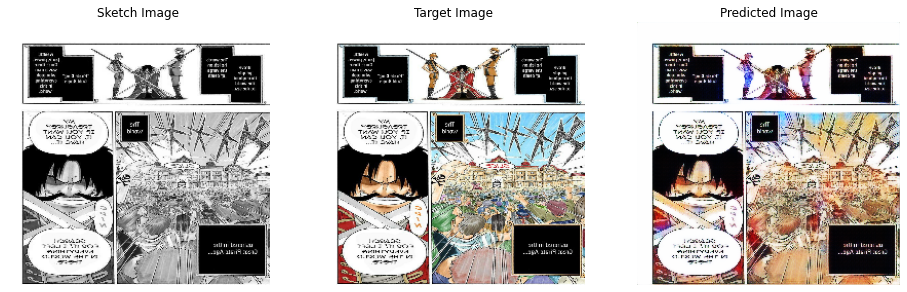

Epoch:  14


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 11.39
Discriminator Loss: 1.12


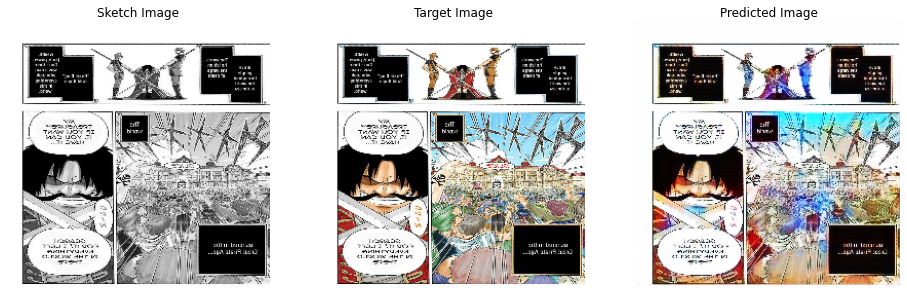

Epoch:  15


100%|██████████| 40/40 [00:08<00:00,  4.52it/s]



Generator Loss: 11.13
Discriminator Loss: 1.14


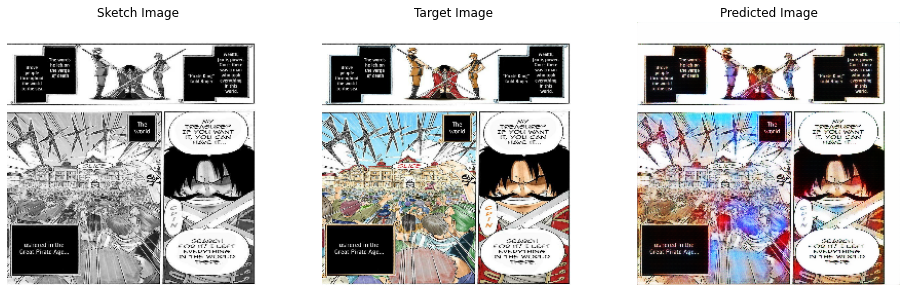

Epoch:  16


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 11.03
Discriminator Loss: 1.12


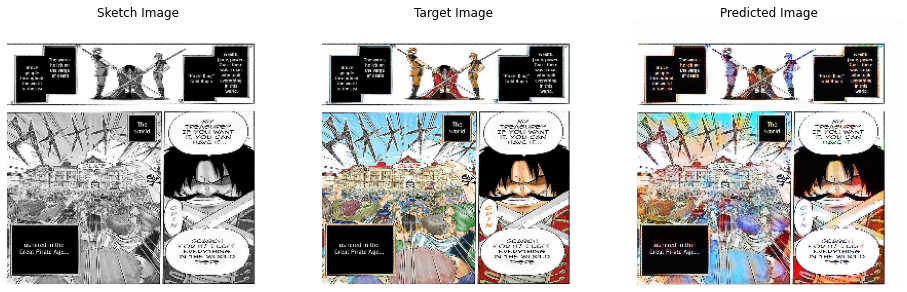

Epoch:  17


100%|██████████| 40/40 [00:09<00:00,  4.22it/s]



Generator Loss: 10.70
Discriminator Loss: 1.16


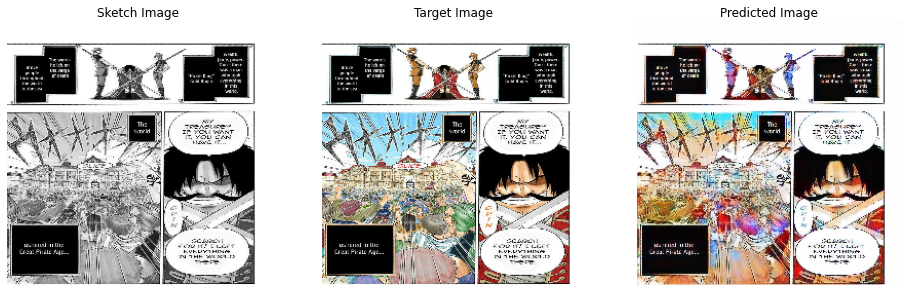

Epoch:  18


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 10.58
Discriminator Loss: 1.19


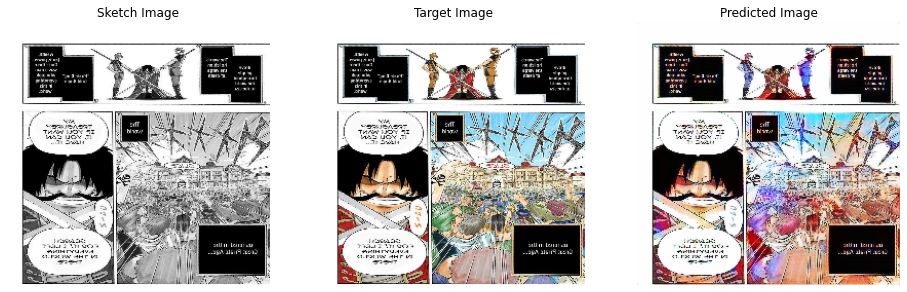

Epoch:  19


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 10.35
Discriminator Loss: 1.09


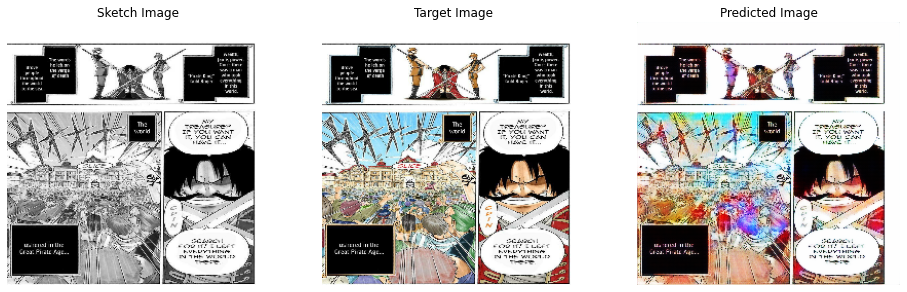

Epoch:  20


100%|██████████| 40/40 [00:10<00:00,  3.90it/s]



Generator Loss: 10.29
Discriminator Loss: 1.20


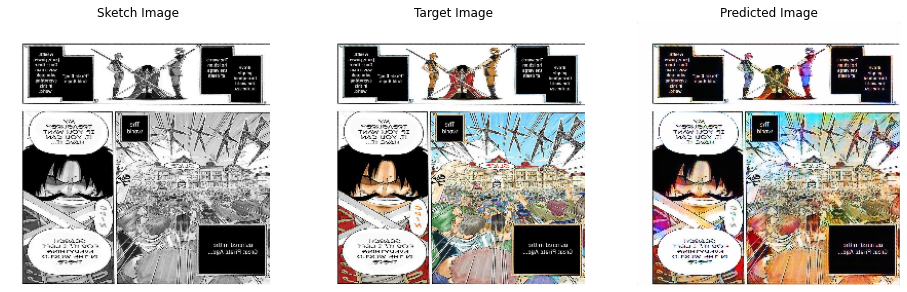

Epoch:  21


100%|██████████| 40/40 [00:08<00:00,  4.46it/s]



Generator Loss: 10.18
Discriminator Loss: 1.13


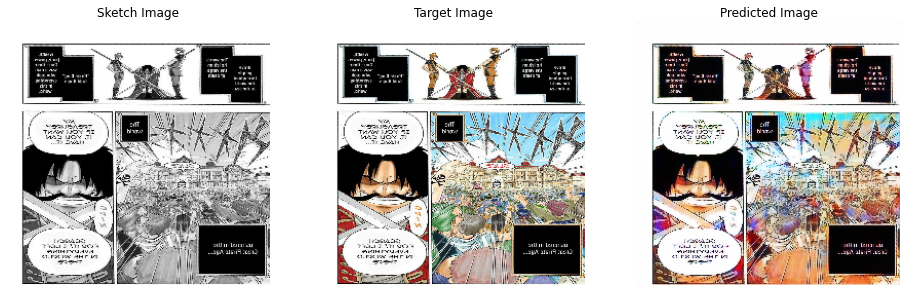

Epoch:  22


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 9.91
Discriminator Loss: 1.13


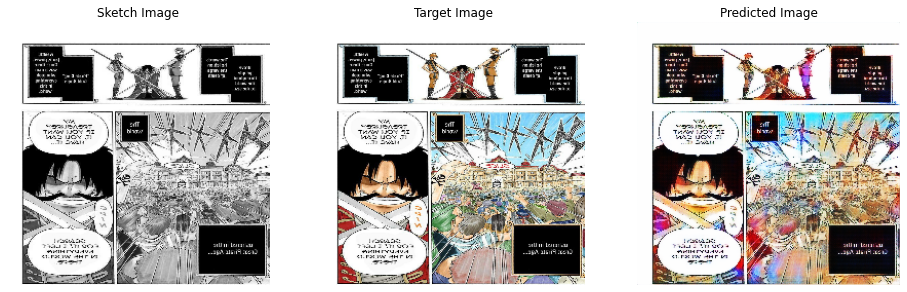

Epoch:  23


100%|██████████| 40/40 [00:08<00:00,  4.50it/s]



Generator Loss: 9.93
Discriminator Loss: 1.17


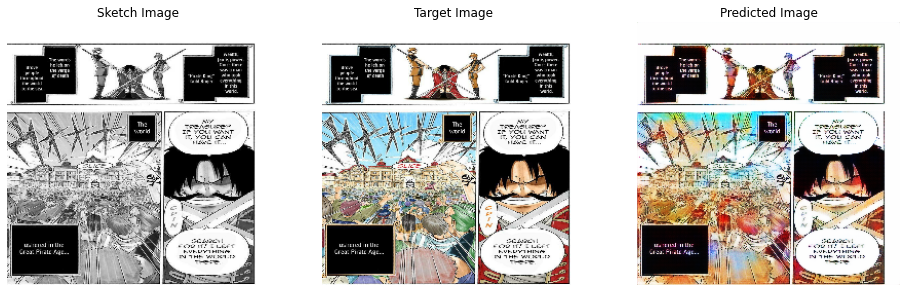

Epoch:  24


100%|██████████| 40/40 [00:08<00:00,  4.51it/s]



Generator Loss: 9.78
Discriminator Loss: 1.08


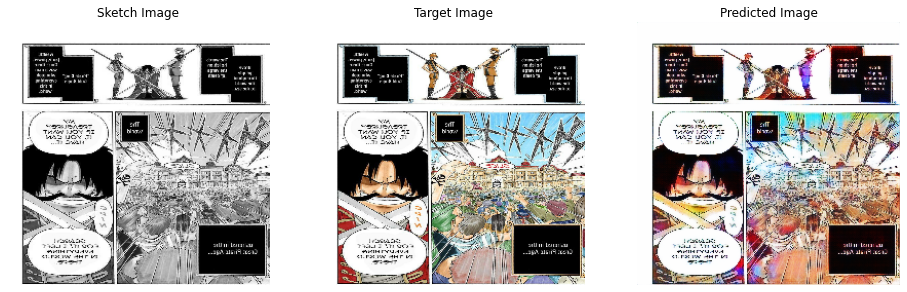

Epoch:  25


100%|██████████| 40/40 [00:10<00:00,  3.90it/s]



Generator Loss: 9.79
Discriminator Loss: 1.14


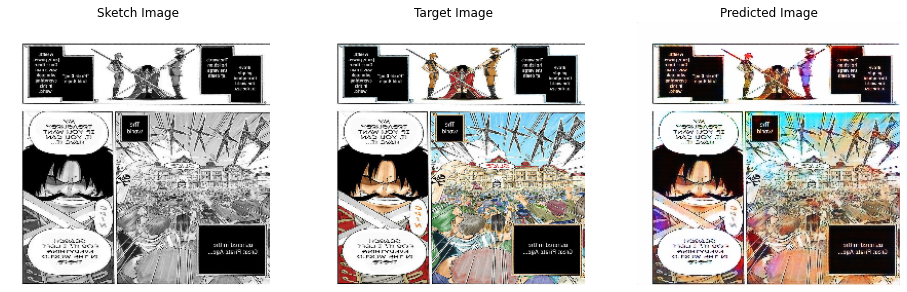

Epoch:  26


100%|██████████| 40/40 [00:08<00:00,  4.47it/s]



Generator Loss: 9.44
Discriminator Loss: 1.12


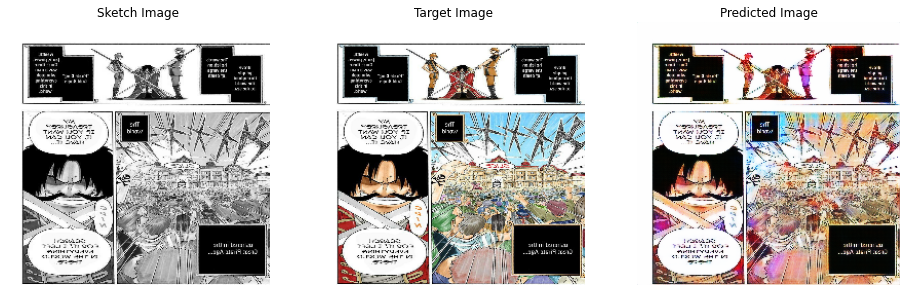

Epoch:  27


100%|██████████| 40/40 [00:09<00:00,  4.31it/s]



Generator Loss: 9.66
Discriminator Loss: 1.26


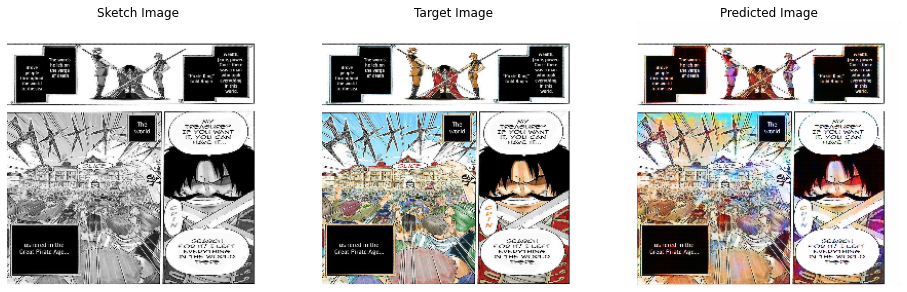

Epoch:  28


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]



Generator Loss: 8.66
Discriminator Loss: 1.26


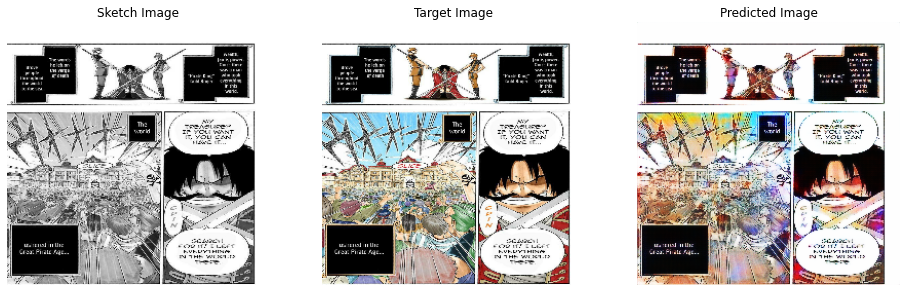

Epoch:  29


100%|██████████| 40/40 [00:10<00:00,  3.90it/s]



Generator Loss: 8.85
Discriminator Loss: 1.11


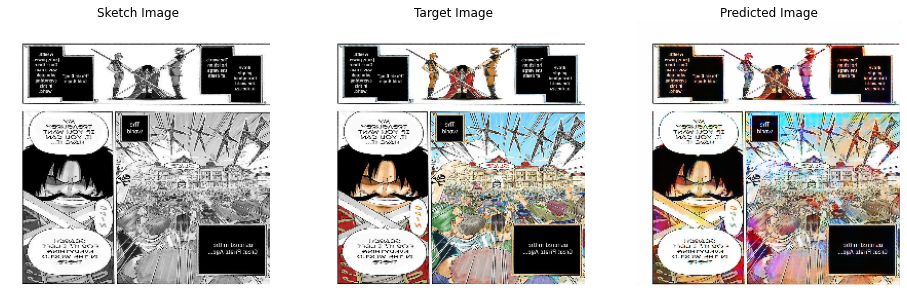

Epoch:  30


100%|██████████| 40/40 [00:10<00:00,  3.91it/s]


Generator Loss: 9.39
Discriminator Loss: 0.99


In [ ]:
fit(train_dataset, EPOCHS, test_dataset)

## Plotting model loss

***Generator loss***

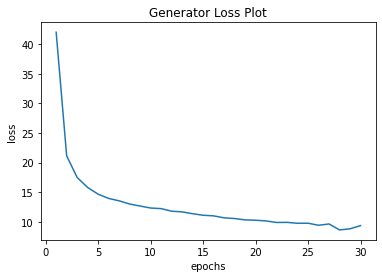

In [ ]:
plt.plot(range(1,EPOCHS+1), generator_mean_losses)
plt.xlabel('epochs')
plt.ylabel('loss')
plt.title('Generator Loss Plot')
plt.show()

***Discriminator loss***

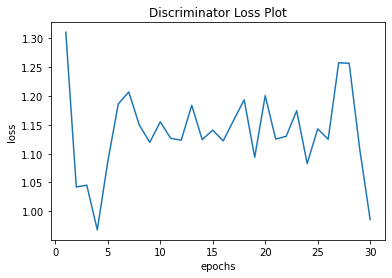

In [ ]:
plt.plot(range(1,EPOCHS+1), discriminator_mean_losses)
plt.xlabel('epochs')
plt.ylabel('loss')
plt.title('Discriminator Loss Plot')
plt.show()

## Results after training

0001-001.png.jpeg


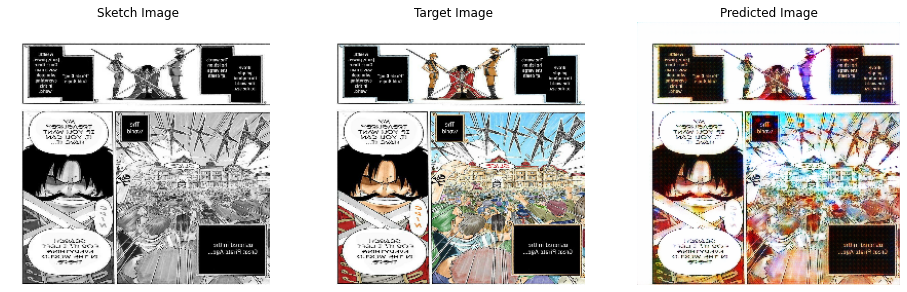

0002-020.png.jpeg


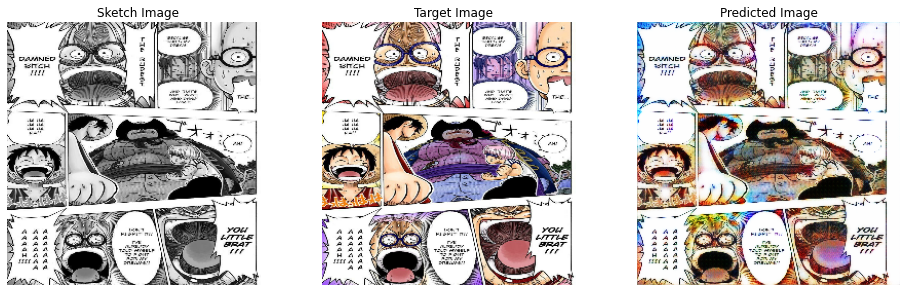

0003-008.png.jpeg


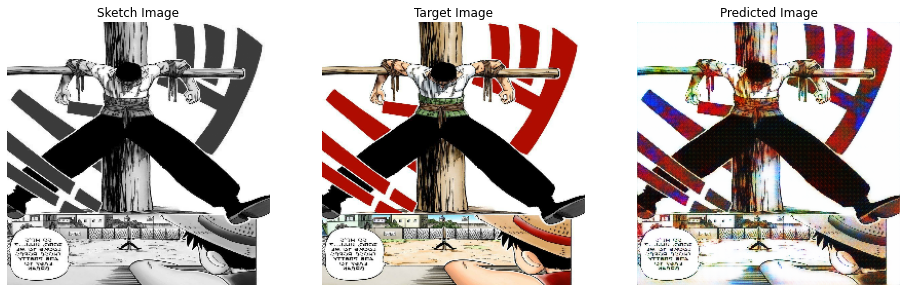

0004-019.png.jpeg


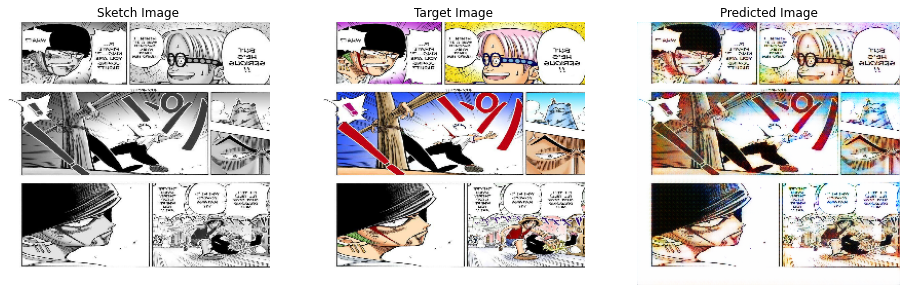

0005-012.png.jpeg


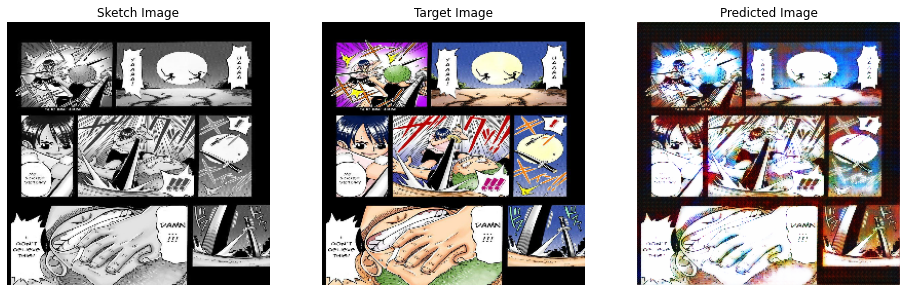

0007-021.png.jpeg


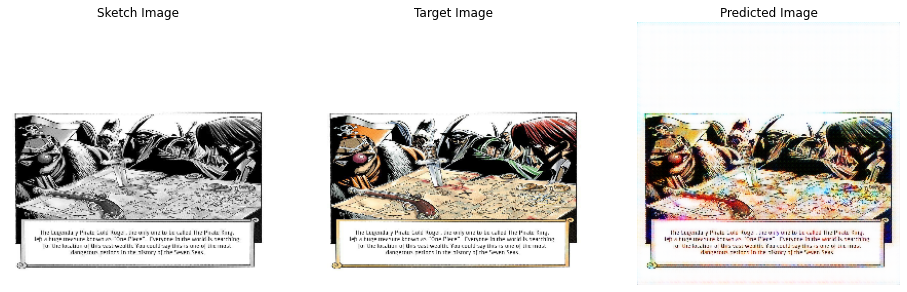

0007-018.png.jpeg


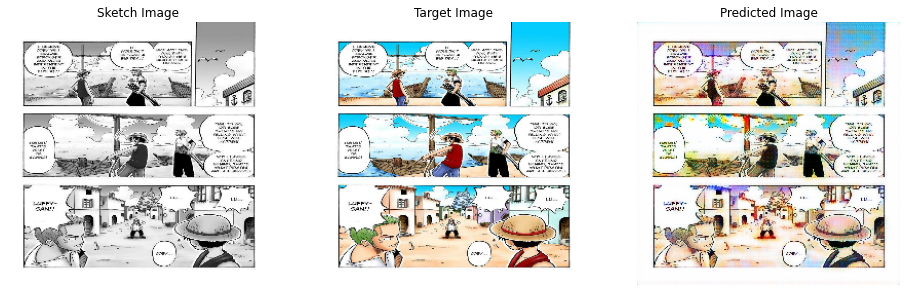

0007-008.png.jpeg


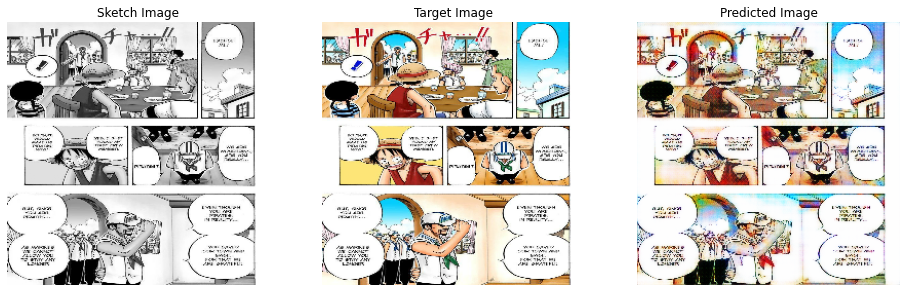

In [ ]:
import PIL.Image
print(zip(test_dataset, test_images_path))

def tensor_to_image(tensor):
    tensor = tensor*255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor)>3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

for data, name in zip(test_dataset, test_images_path):
    name = name[0].split("/")
    name = name[len(name) - 1]
    print(name)
    decolored_image = data[0]
    ground_truth = data[1]
    gen = generate_images(generator, decolored_image, ground_truth)
    tf.keras.preprocessing.image.save_img("/content/drive/MyDrive/DL/Result/cGAN/" + name, x = tensor_to_image(gen))

## Saving model

In [ ]:
#generator.save('pix2pix_generator.h5')
#discriminator.save('pix2pix_discriminator.h5')

# References

1. Image-to-Image Translation with Conditional Adversarial Networks https://arxiv.org/pdf/1611.07004.pdf

2. User-Guided Deep Anime Line Art Colorization with Conditional Adversarial Networks https://arxiv.org/pdf/1808.03240.pdf

3. Anime Art [Danbooru 2020 Small] https://www.kaggle.com/muoncollider/Danbooru2020Small

4. XDoG: An eXtended difference-of-Gaussians compendium including advanced image stylization \
https://users.cs.northwestern.edu/~sco590/winnemoeller-cag2012.pdf

5. python-xdog https://github.com/heitorrapela/xdog

6. XDoG-Python https://github.com/garygrossi/XDoG-Python

7. Anime Sketch Colorization Pair: https://www.kaggle.com/ktaebum/anime-sketch-colorization-pair

8. Introduction to generative adversarial networks (GANs): https://atcold.github.io/pytorch-Deep-Learning/en/week09/09-3/

9. Image Super-Resolution Using Deep Convolutional Networks https://arxiv.org/abs/1501.00092 

10. How-To: Python Compare Two Images https://pyimagesearch.com/2014/09/15/python-compare-two-images/

11. Super-Resolution Convolutional Neural Network https://colab.research.google.com/github/goodboychan/chans_jupyter/blob/main/_notebooks/2020-10-13-01-Super-Resolution-CNN.ipynb#scrollTo=QrldA7NoeylK

12. Manga Colorization dataset
https://github.com/sudheerachary/Manga_Colorization/tree/master/datasets

13. cGAN-based Manga Colorization Using a Single Training Image https://arxiv.org/abs/1706.06918

14. Writing a training loop from scratch https://keras.io/guides/writing_a_training_loop_from_scratch/

15. Build TensorFlow input Pipelines https://www.tensorflow.org/guide/data